# Spotify Music Recommender

## Getting the Data

In [1]:
import spotipy
from spotipy.oauth2 import SpotifyOAuth
import pandas as pd

In [2]:
sp = spotipy.Spotify(auth_manager=SpotifyOAuth(client_id='d84eae14b11c4a46b3c89fbdab15cdd3',
                                               client_secret= 'f9cf7df772cf4c2f906c4934377cfe3d', 
                                               redirect_uri='http://localhost:9000', scope="user-read-recently-played"))

### Scraping Recently Played Tracks

In [5]:
recently_played = sp.current_user_recently_played()

In [6]:
recents_df = pd.DataFrame(recently_played['items'])
recents_df.head()

,track,played_at,context
0,"{'album': {'album_type': 'album', 'artists': [...",2022-05-13T00:48:30.438Z,None
1,"{'album': {'album_type': 'album', 'artists': [...",2022-05-13T00:42:58.654Z,None
2,"{'album': {'album_type': 'album', 'artists': [...",2022-05-13T00:39:20.970Z,None
3,"{'album': {'album_type': 'album', 'artists': [...",2022-05-12T22:29:44.899Z,None
4,"{'album': {'album_type': 'single', 'artists': ...",2022-05-12T22:25:52.152Z,None


In [7]:
tracks = []
artists = []

for idx, item in enumerate(recently_played['items']):
    track = item['track']
    tracks.append(track['name'])
    artists.append(track['artists'][0]['name'])

recents_df['track_name'] = tracks
recents_df['artist_name'] = artists

In [8]:
recents_df.head()

,track,played_at,context,track_name,artist_name
0,"{'album': {'album_type': 'album', 'artists': [...",2022-05-13T00:48:30.438Z,None,Change,J. Cole
1,"{'album': {'album_type': 'album', 'artists': [...",2022-05-13T00:42:58.654Z,None,Price On My Head (feat. The Weeknd),NAV
2,"{'album': {'album_type': 'album', 'artists': [...",2022-05-13T00:39:20.970Z,None,Mr. Rager,Kid Cudi
3,"{'album': {'album_type': 'album', 'artists': [...",2022-05-12T22:29:44.899Z,None,FEEL.,Kendrick Lamar
4,"{'album': {'album_type': 'single', 'artists': ...",2022-05-12T22:25:52.152Z,None,Want Beef?,YSN Flow


In [9]:
recents_df.drop(["track", "played_at", "context"], axis = 1, inplace = True)
recents_df.drop_duplicates(subset = 'track_name', inplace = True)

recents_df.head()

,track_name,artist_name
0,Change,J. Cole
1,Price On My Head (feat. The Weeknd),NAV
2,Mr. Rager,Kid Cudi
3,FEEL.,Kendrick Lamar
4,Want Beef?,YSN Flow


### Scraping Top Artists & Tracks

In [13]:
sp2 = spotipy.Spotify(auth_manager=SpotifyOAuth(client_id='d84eae14b11c4a46b3c89fbdab15cdd3',
                                               client_secret= 'f9cf7df772cf4c2f906c4934377cfe3d', 
                                               redirect_uri='http://localhost:9000', scope='user-top-read'))

In [14]:
top_artists = sp2.current_user_top_artists(limit = 50)

In [15]:
artists_df = pd.DataFrame(top_artists['items'])

In [16]:
artists_df.drop(["external_urls", "followers", "href", "id", "images", "type", "uri"], axis = 1, inplace = True)
artists_df.head()

,genres,name,popularity
0,"[canadian hip hop, canadian pop, hip hop, rap,...",Drake,95
1,"[melodic rap, rap, trap]",A Boogie Wit da Hoodie,83
2,"[atl hip hop, melodic rap, rap, trap]",Gunna,88
3,"[chicago rap, rap]",Kanye West,92
4,"[hip hop, rap, slap house, trap]",Travis Scott,89


In [17]:
top_tracks = sp2.current_user_top_tracks(limit = 50)

In [18]:
tracks_df = pd.DataFrame(top_tracks['items'])
tracks_df.head()

,album,artists,available_markets,disc_number,duration_ms,explicit,external_ids,external_urls,href,id,is_local,name,popularity,preview_url,track_number,type,uri
0,"{'album_type': 'SINGLE', 'artists': [{'externa...",[{'external_urls': {'spotify': 'https://open.s...,"[AD, AE, AR, AT, AU, BE, BG, BH, BO, BR, CA, C...",1,197616,False,{'isrc': 'QZAKB2103992'},{'spotify': 'https://open.spotify.com/track/1K...,https://api.spotify.com/v1/tracks/1K5whJr9TAgF...,1K5whJr9TAgFAohNbp26Qg,False,Flight of the Mitoglider,41,https://p.scdn.co/mp3-preview/c6c1f3501a9b2dd8...,1,track,spotify:track:1K5whJr9TAgFAohNbp26Qg
1,"{'album_type': 'ALBUM', 'artists': [{'external...",[{'external_urls': {'spotify': 'https://open.s...,"[AD, AE, AR, AT, AU, BE, BG, BH, BO, BR, CA, C...",1,215303,True,{'isrc': 'USAT22108046'},{'spotify': 'https://open.spotify.com/track/7u...,https://api.spotify.com/v1/tracks/7uLFOXgLrS90...,7uLFOXgLrS90tEYPO1DGXy,False,Man in the Mirror,74,https://p.scdn.co/mp3-preview/db761c52a412965a...,1,track,spotify:track:7uLFOXgLrS90tEYPO1DGXy
2,"{'album_type': 'ALBUM', 'artists': [{'external...",[{'external_urls': {'spotify': 'https://open.s...,"[AD, AE, AR, AT, AU, BE, BG, BH, BO, BR, CA, C...",1,165066,True,{'isrc': 'USAT22106845'},{'spotify': 'https://open.spotify.com/track/4K...,https://api.spotify.com/v1/tracks/4KDNRh9Oor80...,4KDNRh9Oor80z3XIxdWlui,False,Bubbly (with Drake & Travis Scott),74,https://p.scdn.co/mp3-preview/e9a563cccea9d4e9...,12,track,spotify:track:4KDNRh9Oor80z3XIxdWlui
3,"{'album_type': 'SINGLE', 'artists': [{'externa...",[{'external_urls': {'spotify': 'https://open.s...,"[AD, AE, AR, AT, AU, BE, BG, BH, BO, BR, CA, C...",1,269333,False,{'isrc': 'DEUM71903009'},{'spotify': 'https://open.spotify.com/track/0o...,https://api.spotify.com/v1/tracks/0oA9wBGDY4uy...,0oA9wBGDY4uyILLg4GymWP,False,Tom's Diner,84,https://p.scdn.co/mp3-preview/33d990dd16c0abc1...,1,track,spotify:track:0oA9wBGDY4uyILLg4GymWP
4,"{'album_type': 'ALBUM', 'artists': [{'external...",[{'external_urls': {'spotify': 'https://open.s...,"[AD, AE, AR, AT, AU, BE, BG, BH, BO, BR, CA, C...",1,193346,True,{'isrc': 'QMCE32200042'},{'spotify': 'https://open.spotify.com/track/0l...,https://api.spotify.com/v1/tracks/0lEjxUUlKqjq...,0lEjxUUlKqjqXrVlIHFduD,False,P power (feat. Drake),78,https://p.scdn.co/mp3-preview/0c6f1a8eb8820ee5...,6,track,spotify:track:0lEjxUUlKqjqXrVlIHFduD


In [19]:
artists = []
for idx, item in enumerate(top_tracks['items']):
    artists.append(item['album']['artists'][0]['name'])

tracks_df['artist'] = artists
tracks_df.drop(["album", "artists", "available_markets", "disc_number", "duration_ms", "explicit",
                "external_ids", "external_urls", "href", "id", "is_local", "preview_url", "track_number",
                "type", "uri"], axis = 1, inplace = True)

tracks_df.head()

,name,popularity,artist
0,Flight of the Mitoglider,41,Myriad of Trees
1,Man in the Mirror,74,A Boogie Wit da Hoodie
2,Bubbly (with Drake & Travis Scott),74,Young Thug
3,Tom's Diner,84,AnnenMayKantereit
4,P power (feat. Drake),78,Gunna


### Adding Personal Streaming Data

In [116]:
df = pd.concat(
    map(pd.read_csv, ['StreamingHistory0.csv', 'StreamingHistory1.csv', 
                      'StreamingHistory2.csv', 'StreamingHistory3.csv']), ignore_index=True)

df.drop(["endTime"], axis = 1, inplace = True)

df['count'] = 1

df['totalPlays'] = df.groupby(['artistName', 'trackName'])['count'].transform('sum')
df.drop(["count"], axis = 1, inplace = True)

df['msPlayed'] = df.groupby(['artistName', 'trackName'])['msPlayed'].transform('sum')
#df.drop(["count"], axis = 1, inplace = True)

df.drop_duplicates(subset = ['artistName', 'trackName'], inplace = True)
df

,artistName,trackName,msPlayed,totalPlays
0,88GLAM,Talk Nice,302476,14
1,Young Stoner Life,Solid (feat. Drake),4866003,46
2,Diplo,Wish,6858278,73
3,Diplo,Wish - Trippie Mix,9055,3
4,POORSTACY,Darkness,14762,1
...,...,...,...,...
32825,Sam Smith,Love Me More,66158,1
32932,Khalid,Skyline,835203,6
32938,Khalid,Outta My Head (with John Mayer),885330,6
32962,Pusha T,Scrape It Off (feat. Lil Uzi Vert & Don Toliver),17152,1


In [72]:
track_id = []
count = 0
total = 0

for row in df.iterrows():
    for i in range(0, 50):
        if total < len(df):
            track_id.append(sp.search(q='artist:' + df.iloc[i + count]['artistName'] +
                                      ' track:' + df.iloc[i + count]['trackName'], type='track'))
        else:
            break
        total += 1
    count += 50
    
track_id

[{'tracks': {'href': 'https://api.spotify.com/v1/search?query=artist%3A88GLAM+track%3ATalk+Nice&type=track&offset=0&limit=10',
   'items': [{'album': {'album_type': 'album',
      'artists': [{'external_urls': {'spotify': 'https://open.spotify.com/artist/2I9SLklAOG0vdMiUUMNxRl'},
        'href': 'https://api.spotify.com/v1/artists/2I9SLklAOG0vdMiUUMNxRl',
        'id': '2I9SLklAOG0vdMiUUMNxRl',
        'name': '88GLAM',
        'type': 'artist',
        'uri': 'spotify:artist:2I9SLklAOG0vdMiUUMNxRl'}],
      'available_markets': ['AD',
       'AE',
       'AG',
       'AL',
       'AM',
       'AO',
       'AR',
       'AT',
       'AU',
       'AZ',
       'BA',
       'BB',
       'BD',
       'BE',
       'BG',
       'BH',
       'BI',
       'BJ',
       'BO',
       'BR',
       'BS',
       'BT',
       'BW',
       'BZ',
       'CA',
       'CD',
       'CG',
       'CH',
       'CI',
       'CL',
       'CM',
       'CO',
       'CR',
       'CV',
       'CW',
       'CY',
   

In [22]:
len(track_id)

2502

In [23]:
import numpy as np

ids = []
popularity = []
i = 0

for track in track_id:
    if not track["tracks"]["items"]:
        ids.append(np.nan)
        popularity.append(np.nan)
    else:
        ids.append(track['tracks']['items'][0]['id'])
        popularity.append(track['tracks']['items'][0]['popularity'])
    i += 1

In [25]:
len(popularity)

2502

In [ ]:
# track = 'spotify:track:6rTInqW3YECMkQsBEHw4sd'
# track = sp.track(track)

# print(track["name"])

In [117]:
df['track_id'] = ids
df['popularity'] = popularity
df.dropna(inplace = True)

In [118]:
df

,artistName,trackName,msPlayed,totalPlays,track_id,popularity
0,88GLAM,Talk Nice,302476,14,16hJhVQWkrbnwYxrtTxK9K,29.0
1,Young Stoner Life,Solid (feat. Drake),4866003,46,6rTInqW3YECMkQsBEHw4sd,75.0
2,Diplo,Wish,6858278,73,6IpvkngH89cA3hhPC84Leg,68.0
3,Diplo,Wish - Trippie Mix,9055,3,6IpvkngH89cA3hhPC84Leg,68.0
4,POORSTACY,Darkness,14762,1,5Uv2JpFljcY0TViBe9rtEl,33.0
...,...,...,...,...,...,...
32825,Sam Smith,Love Me More,66158,1,16MQETUgqXwY4lZcyRafU3,76.0
32932,Khalid,Skyline,835203,6,1QxIFMs4M8qd5cbJJu80v4,76.0
32938,Khalid,Outta My Head (with John Mayer),885330,6,09oZ9eXQ2fo6YDrPzJqAoP,64.0
32962,Pusha T,Scrape It Off (feat. Lil Uzi Vert & Don Toliver),17152,1,1dp8aQANyTRKssDeAYPiZe,76.0


In [41]:
audio_features = []
i = 0
total = 0

for row in df.iterrows():
    if total < len(df):
        audio_features.append(sp.audio_features(df.iloc[i]['track_id']))
    else:
        break
    i += 1
    total += 1

audio_features

[[{'danceability': 0.807,
   'energy': 0.619,
   'key': 0,
   'loudness': -6.573,
   'mode': 1,
   'speechiness': 0.156,
   'acousticness': 0.275,
   'instrumentalness': 0,
   'liveness': 0.109,
   'valence': 0.153,
   'tempo': 146.051,
   'type': 'audio_features',
   'id': '16hJhVQWkrbnwYxrtTxK9K',
   'uri': 'spotify:track:16hJhVQWkrbnwYxrtTxK9K',
   'track_href': 'https://api.spotify.com/v1/tracks/16hJhVQWkrbnwYxrtTxK9K',
   'analysis_url': 'https://api.spotify.com/v1/audio-analysis/16hJhVQWkrbnwYxrtTxK9K',
   'duration_ms': 239587,
   'time_signature': 4}],
 [{'danceability': 0.887,
   'energy': 0.485,
   'key': 11,
   'loudness': -9.358,
   'mode': 0,
   'speechiness': 0.2,
   'acousticness': 0.0392,
   'instrumentalness': 0,
   'liveness': 0.141,
   'valence': 0.328,
   'tempo': 125.987,
   'type': 'audio_features',
   'id': '6rTInqW3YECMkQsBEHw4sd',
   'uri': 'spotify:track:6rTInqW3YECMkQsBEHw4sd',
   'track_href': 'https://api.spotify.com/v1/tracks/6rTInqW3YECMkQsBEHw4sd',
   'a

In [42]:
len(audio_features)

2453

In [119]:
danceability = []
energy = []
loudness = []
speechiness = []
acousticness = []
instrumentalness = []
liveness = []
valence = []
tempo = []

for feature in audio_features:
    danceability.append(feature[0]['danceability'])
    energy.append(feature[0]['energy'])
    loudness.append(feature[0]['loudness'])
    speechiness.append(feature[0]['speechiness'])
    acousticness.append(feature[0]['acousticness'])
    instrumentalness.append(feature[0]['instrumentalness'])
    liveness.append(feature[0]['liveness'])
    valence.append(feature[0]['valence'])
    tempo.append(feature[0]['tempo'])
    
df['danceability'] = danceability
df['energy'] = energy
df['loudness'] = loudness
df['speechiness'] = speechiness
df['acousticness'] = acousticness
df['instrumentalness'] = instrumentalness
df['liveness'] = liveness
df['valence'] = valence
df['tempo'] = tempo

df = df[["track_id", "artistName", "trackName", "msPlayed", "totalPlays", 'popularity', 'danceability',
         'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo']]
df

,track_id,artistName,trackName,msPlayed,totalPlays,popularity,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo
0,16hJhVQWkrbnwYxrtTxK9K,88GLAM,Talk Nice,302476,14,29.0,0.807,0.619,-6.573,0.1560,0.275000,0.000000,0.109,0.153,146.051
1,6rTInqW3YECMkQsBEHw4sd,Young Stoner Life,Solid (feat. Drake),4866003,46,75.0,0.887,0.485,-9.358,0.2000,0.039200,0.000000,0.141,0.328,125.987
2,6IpvkngH89cA3hhPC84Leg,Diplo,Wish,6858278,73,68.0,0.561,0.832,-7.661,0.0717,0.232000,0.000000,0.107,0.666,93.991
3,6IpvkngH89cA3hhPC84Leg,Diplo,Wish - Trippie Mix,9055,3,68.0,0.561,0.832,-7.661,0.0717,0.232000,0.000000,0.107,0.666,93.991
4,5Uv2JpFljcY0TViBe9rtEl,POORSTACY,Darkness,14762,1,33.0,0.486,0.709,-4.362,0.0331,0.000648,0.000000,0.148,0.868,144.889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32825,16MQETUgqXwY4lZcyRafU3,Sam Smith,Love Me More,66158,1,76.0,0.791,0.439,-5.620,0.0645,0.302000,0.000018,0.126,0.559,85.004
32932,1QxIFMs4M8qd5cbJJu80v4,Khalid,Skyline,835203,6,76.0,0.733,0.653,-6.094,0.0391,0.017900,0.021800,0.184,0.752,119.996
32938,09oZ9eXQ2fo6YDrPzJqAoP,Khalid,Outta My Head (with John Mayer),885330,6,64.0,0.729,0.545,-7.818,0.0316,0.017400,0.000274,0.369,0.514,103.012
32962,1dp8aQANyTRKssDeAYPiZe,Pusha T,Scrape It Off (feat. Lil Uzi Vert & Don Toliver),17152,1,76.0,0.594,0.679,-3.702,0.3450,0.484000,0.000008,0.114,0.660,106.726


## Data Exploration

In [79]:
%pip install seaborn;

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [108]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as plticker
from matplotlib import pyplot as plt
%matplotlib inline

sns.set_theme(context='notebook', style='whitegrid', palette='pastel', font='sans-serif', font_scale=1)

[Text(0.5, 1.0, 'Correlation Between Song Features')]

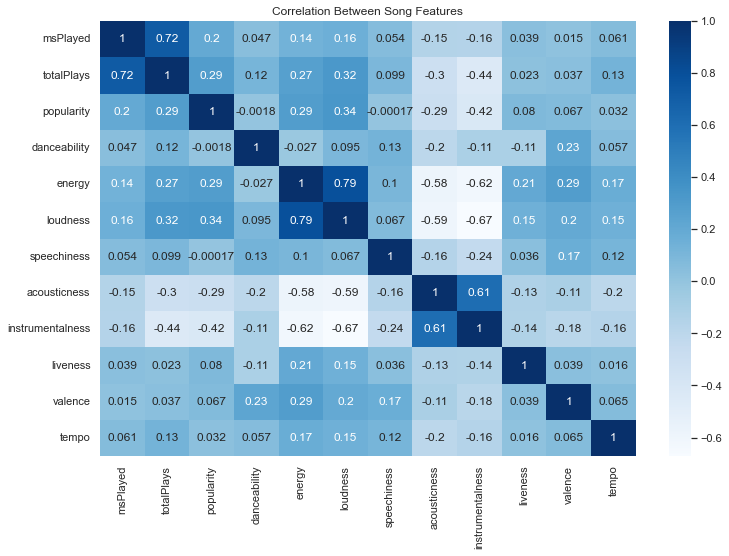

In [120]:
# HeatMap of Correlations Between Features
corr = df.corr()
plt.figure(figsize=(12,8))
sns.heatmap(corr, cmap = "Blues", annot=True).set(title='Correlation Between Song Features')

In [131]:
df2 = df.sort_values(by = ['totalPlays'], ascending = False)
df2 = df2.head(10)
df2.head(3)

,track_id,artistName,trackName,msPlayed,totalPlays,popularity,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo
12387,1K5whJr9TAgFAohNbp26Qg,Myriad of Trees,Flight of the Mitoglider,17227677,96,41.0,0.718,0.297,-10.008,0.0419,0.7120,0.891,0.1190,0.263,70.000
3614,1EnWTwagv0XR5OJ51WMdzj,Polo G,Go Part 1 (with G Herbo),11882132,90,55.0,0.664,0.375,-9.768,0.3870,0.0135,0.000,0.1170,0.145,171.784
3626,2NM0qHzx4Ohy8iXHEEgwlO,Migos,Having Our Way (feat. Drake),14067446,76,65.0,0.927,0.538,-3.917,0.1160,0.0312,0.000,0.0945,0.221,125.983


In [129]:
# Normalize Audio Feature Columns & Scatterplot based on Features (X-Axis is Features)

In [ ]:
# Bar Graph of Most Listened to Songs in the Past Year (By msPlayed and totalPlays)

In [132]:
# Boxplot of Average Value by Feature

## Model Creation